# Clustering and dimeonsionality reduction techniques combined

In this notebook, we show how the clustering performance changes when dimensionality reduction techniques like Principal component analysis (PCA), Independent component analysis (ICA), or Random projections (RP) is combined with algorithms like k-means.

[Read about ___k-means clustering algorithm___ here.](https://en.wikipedia.org/wiki/K-means_clustering)

[Read about ___principal component analysis___ here](https://en.wikipedia.org/wiki/Principal_component_analysis)

[Read about ___independent component analysis___ here](https://en.wikipedia.org/wiki/Independent_component_analysis)

---

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

### Create synthetic data using Scikit learn `make_blob` method

- Number of features: 8
- Number of clusters: 5
- Number of samples: 1000

In [2]:
from sklearn.datasets import make_classification
from sklearn.datasets import make_blobs

In [3]:
n_features = 8
n_cluster = 5
cluster_std = 1.5
n_samples = 1000

In [4]:
data1 = make_blobs(n_samples=n_samples,n_features=n_features,centers=n_cluster,cluster_std=cluster_std)

In [5]:
d1 = data1[0]

In [6]:
df1=pd.DataFrame(data=d1,columns=['Feature_'+str(i) for i in range(1,n_features+1)])
df1.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8
0,1.559361,-5.171554,9.905848,-2.376801,-8.421168,-1.111731,0.349635,-8.174084
1,3.161694,-4.704035,6.078940,-4.054484,-9.394845,-2.270716,-0.588952,-3.671187
2,-3.221831,10.781459,6.465597,-7.919139,2.387145,-2.002747,-3.200427,-8.289685
3,-2.549458,7.539798,5.811345,-6.202081,-1.440887,-2.276072,0.284905,-4.717213
4,-1.944984,10.801419,3.988110,-2.409945,-1.185801,-11.352511,5.902931,-1.907921


In [7]:
from itertools import combinations

In [8]:
lst_vars=list(combinations(df1.columns,2))

In [9]:
len(lst_vars)

28

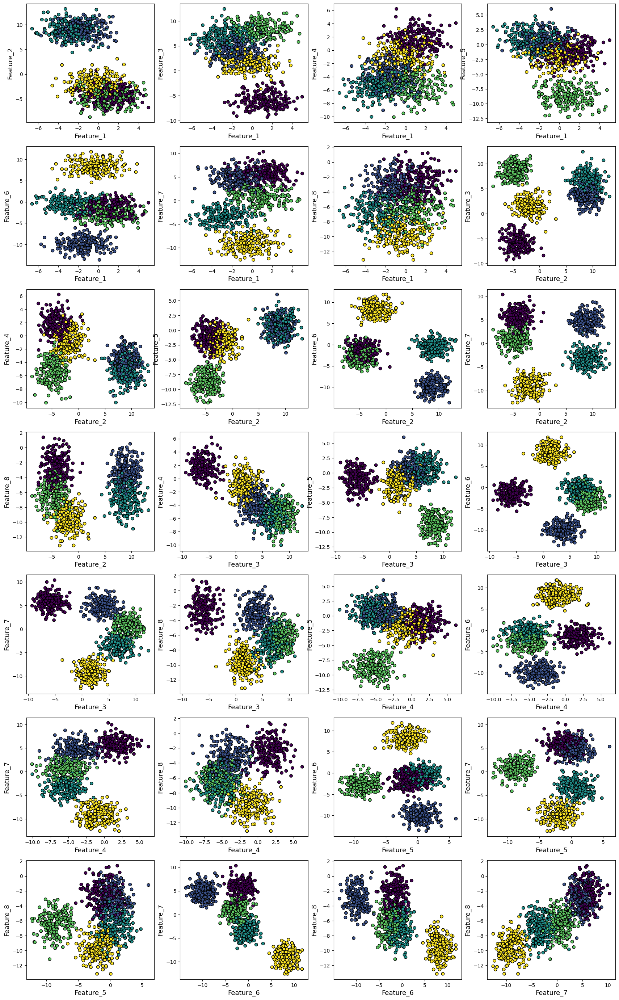

In [10]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=data1[1],edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

In [11]:
df1.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Feature_1,1000.0,-0.513073,2.110472,-6.606664,-2.010204,-0.463618,1.003700,5.000469
Feature_2,1000.0,1.415943,6.381334,-8.719033,-4.066384,-1.702911,8.427575,13.195003
Feature_3,1000.0,2.907186,5.229954,-9.304973,0.478550,3.887384,7.090450,12.408058
Feature_4,1000.0,-2.742557,3.156948,-10.080410,-5.187388,-3.352661,-0.181676,6.211228
Feature_5,1000.0,-2.095783,3.742577,-12.263503,-3.299217,-1.054393,0.485228,6.020094
Feature_6,1000.0,-1.236966,5.989552,-13.668756,-3.941363,-1.449231,0.845819,11.812246
Feature_7,1000.0,-0.213939,5.671407,-12.582757,-4.429734,0.854140,4.777951,10.351382
Feature_8,1000.0,-5.680134,3.017769,-13.132725,-8.027883,-5.644987,-3.302918,1.387053


### How are the classes separated (boxplots)

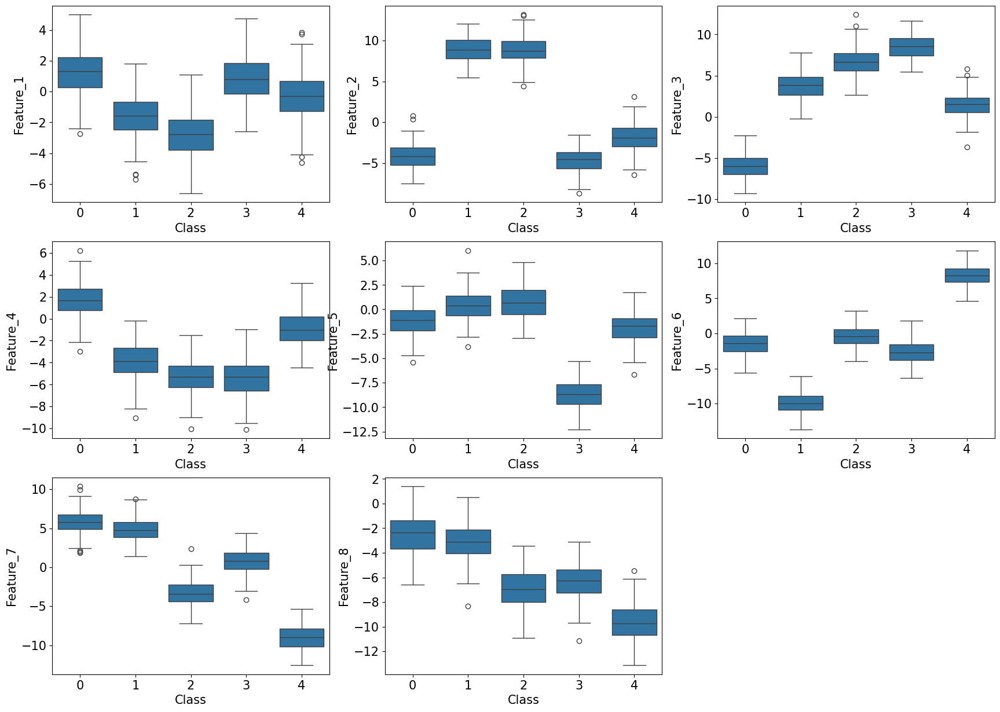

In [12]:
plt.figure(figsize=(21,15))
for i,c in enumerate(df1.columns):
    plt.subplot(3,3,i+1)
    sns.boxplot(y=df1[c],x=data1[1])
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.xlabel("Class",fontsize=15)
    plt.ylabel(c,fontsize=15)
    #plt.show()

## k-means clustering

In [13]:
from sklearn.cluster import KMeans

### Unlabled data

In [14]:
X=df1

In [15]:
X.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8
0,1.559361,-5.171554,9.905848,-2.376801,-8.421168,-1.111731,0.349635,-8.174084
1,3.161694,-4.704035,6.078940,-4.054484,-9.394845,-2.270716,-0.588952,-3.671187
2,-3.221831,10.781459,6.465597,-7.919139,2.387145,-2.002747,-3.200427,-8.289685
3,-2.549458,7.539798,5.811345,-6.202081,-1.440887,-2.276072,0.284905,-4.717213
4,-1.944984,10.801419,3.988110,-2.409945,-1.185801,-11.352511,5.902931,-1.907921


In [16]:
y=data1[1]

### Scaling

In [17]:
from sklearn.preprocessing import MinMaxScaler

In [18]:
scaler = MinMaxScaler()

In [19]:
X_scaled=scaler.fit_transform(X)

### Metrics

In [20]:
from sklearn.metrics import silhouette_score, adjusted_rand_score, completeness_score, v_measure_score

### Running k-means and computing inter-cluster distance score for various *k* values

In [21]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_scaled)
    preds = km.predict(X_scaled)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_scaled)))
    km_scores.append(-km.score(X_scaled))
    silhouette = silhouette_score(X_scaled,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -274.05350903966047
Silhouette score for number of cluster(s) 2: 0.3478185139362435
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -188.66520642171193
Silhouette score for number of cluster(s) 3: 0.4305170073864839
V-measure score for number of cluster(s) 3: 0.7918756684685214
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -96.74026423120851
Silhouette score for number of cluster(s) 4: 0.5599800508196314
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -59.38682188919163
Silhouette score for number of cluster(s) 5: 0.5852512076897642
V-measure score for number of cluster(s

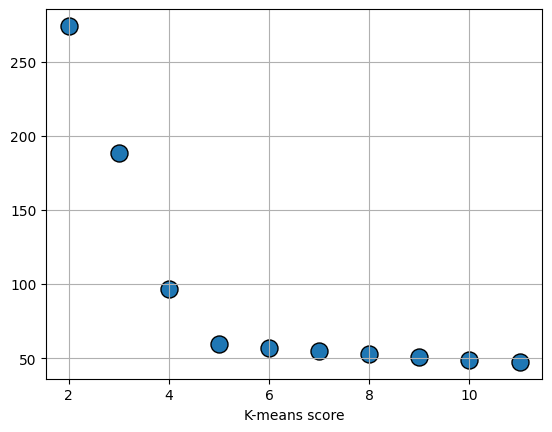

In [22]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("K-means score")
plt.show()

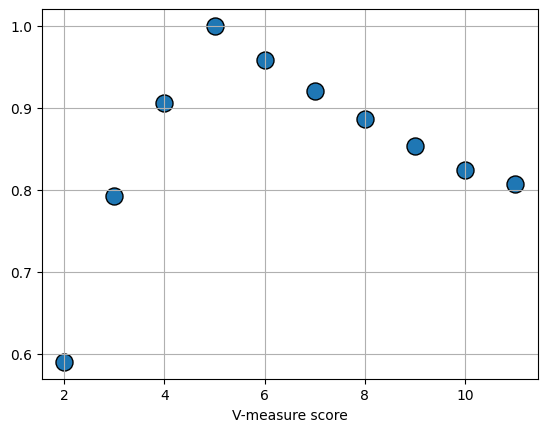

In [23]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("V-measure score")
plt.show()

In [24]:
km = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_scaled)

In [25]:
preds_km = km.predict(X_scaled)

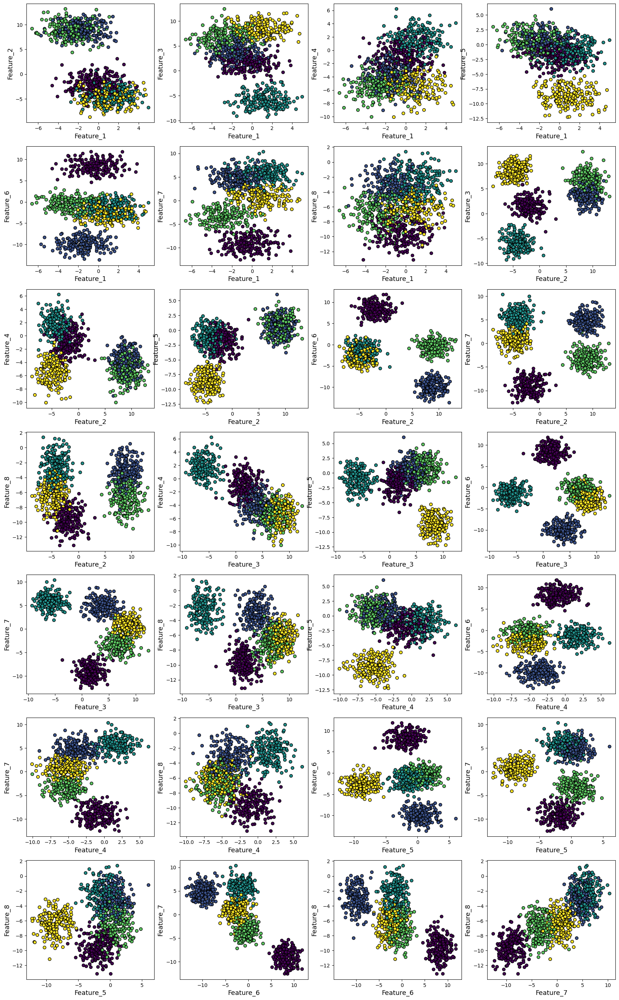

In [26]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=preds_km,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## Expectation-maximization (Gaussian Mixture Model)

In [27]:
from sklearn.mixture import GaussianMixture

In [28]:
gm_bic= []
gm_score=[]
for i in range(2,12):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_scaled)
    print("BIC for number of cluster(s) {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of cluster(s) {}: {}".format(i,gm.score(X_scaled)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_scaled))
    gm_score.append(gm.score(X_scaled))

BIC for number of cluster(s) 2: -10470.138629046573
Log-likelihood score for number of cluster(s) 2: 5.542464424437991
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 3: -11927.013479962232
Log-likelihood score for number of cluster(s) 3: 6.426326343672919
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 4: -12580.525684973469
Log-likelihood score for number of cluster(s) 4: 6.908506939955636
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 5: -12993.804435760252
Log-likelihood score for number of cluster(s) 5: 7.270570809126125
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 6: -12740.615587641585
Log-likelihood score for number of cluster(s) 6: 7.2994008788438896


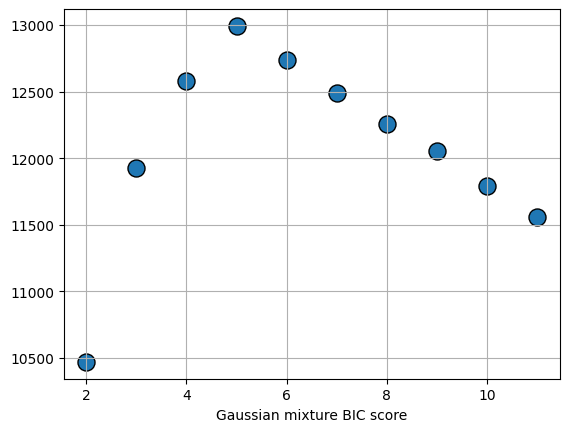

In [29]:
plt.scatter(x=[i for i in range(2,12)],y=gm_bic,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Gaussian mixture BIC score")
plt.show()

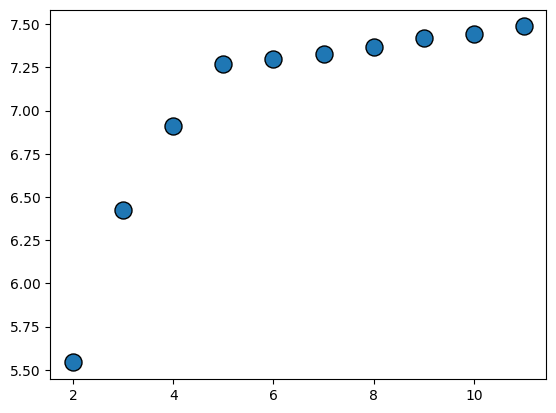

In [30]:
plt.scatter(x=[i for i in range(2,12)],y=gm_score,s=150,edgecolor='k')
plt.show()

In [31]:
gm = GaussianMixture(n_components=5,verbose=1,n_init=10,tol=1e-2,covariance_type='full',max_iter=1000).fit(X_scaled)

Initialization 0
Initialization converged.
Initialization 1
Initialization converged.
Initialization 2
Initialization converged.
Initialization 3
Initialization converged.
Initialization 4
Initialization converged.
Initialization 5
Initialization converged.
Initialization 6
Initialization converged.
Initialization 7
Initialization converged.
Initialization 8
Initialization converged.
Initialization 9
Initialization converged.


In [32]:
gm.means_

array([[0.43669328, 0.80466866, 0.60020253, 0.3828534 , 0.6955513 ,
        0.14769865, 0.7581379 , 0.69384082],
       [0.64309002, 0.1835748 , 0.81781948, 0.2893038 , 0.19620479,
        0.4309582 , 0.58018183, 0.46854688],
       [0.53976852, 0.31185581, 0.49896585, 0.56359558, 0.56951365,
        0.86141505, 0.15432516, 0.24181013],
       [0.67384899, 0.20745578, 0.15669763, 0.7246886 , 0.60817477,
        0.47961407, 0.80042726, 0.73405821],
       [0.33153279, 0.80488434, 0.73848725, 0.29158885, 0.71111335,
        0.51973738, 0.40352304, 0.42810214]])

In [33]:
km.cluster_centers_

array([[0.53976852, 0.31185581, 0.49896585, 0.56359558, 0.56951365,
        0.86141505, 0.15432516, 0.24181013],
       [0.43669329, 0.80466867, 0.60020252, 0.38285341, 0.69555129,
        0.14769863, 0.75813791, 0.69384086],
       [0.67384899, 0.20745578, 0.15669763, 0.7246886 , 0.60817477,
        0.47961407, 0.80042726, 0.73405821],
       [0.3315328 , 0.80488433, 0.73848725, 0.29158885, 0.71111335,
        0.51973736, 0.40352307, 0.42810212],
       [0.64309002, 0.1835748 , 0.81781948, 0.2893038 , 0.19620479,
        0.4309582 , 0.58018183, 0.46854688]])

In [34]:
gm.means_/km.cluster_centers_

array([[0.80903807, 2.58025872, 1.202893  , 0.67930519, 1.22130751,
        0.1714605 , 4.91260084, 2.86936211],
       [1.47263546, 0.22813713, 1.36257257, 0.75565161, 0.28208529,
        2.91782124, 0.76527215, 0.67529445],
       [0.80102297, 1.5032399 , 3.18425908, 0.77770725, 0.93643091,
        1.79605876, 0.19280348, 0.32941546],
       [2.03252589, 0.25774608, 0.21218732, 2.48530974, 0.85524307,
        0.92280083, 1.98359729, 1.71468015],
       [0.51553092, 4.38450332, 0.90299542, 1.00789846, 3.6243425 ,
        1.20600415, 0.69551134, 0.91368048]])

In [35]:
preds_gm=gm.predict(X_scaled)

In [36]:
km_rand_score = adjusted_rand_score(preds_km,y)

In [37]:
gm_rand_score = adjusted_rand_score(preds_gm,y)

In [38]:
print("Adjusted Rand score for k-means",km_rand_score)
print("Adjusted Rand score for Gaussian Mixture model",gm_rand_score)

Adjusted Rand score for k-means 1.0
Adjusted Rand score for Gaussian Mixture model 1.0


In [39]:
silhouette_score(X_scaled,preds_km)

0.5852512076897642

In [40]:
silhouette_score(X_scaled,preds_gm)

0.5852512076897642

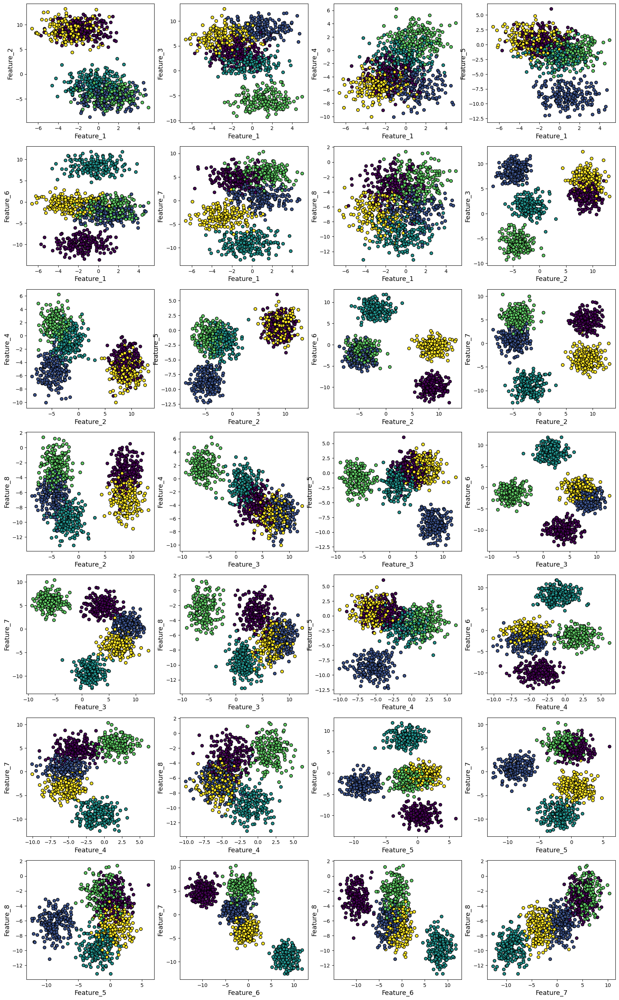

In [41]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=preds_gm,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## PCA

In [42]:
from sklearn.decomposition import PCA

In [43]:
n_prin_comp = 3

In [44]:
pca_partial = PCA(n_components=n_prin_comp,svd_solver='full')
pca_partial.fit(X_scaled)

PCA(n_components=3, svd_solver='full')

In [45]:
pca_full = PCA(n_components=n_features,svd_solver='full')
pca_full.fit(X_scaled)

PCA(n_components=8, svd_solver='full')

### How much variance is explained by principal components?

With the help of this plot, we can decide to work with only the first 3 principal components

In [46]:
pca_explained_var = pca_full.explained_variance_ratio_

In [47]:
cum_explaiend_var = pca_explained_var.cumsum()

In [48]:
cum_explaiend_var

array([0.36731365, 0.6996909 , 0.89895917, 0.9353895 , 0.95698257,
       0.97627755, 0.98979793, 1.        ])

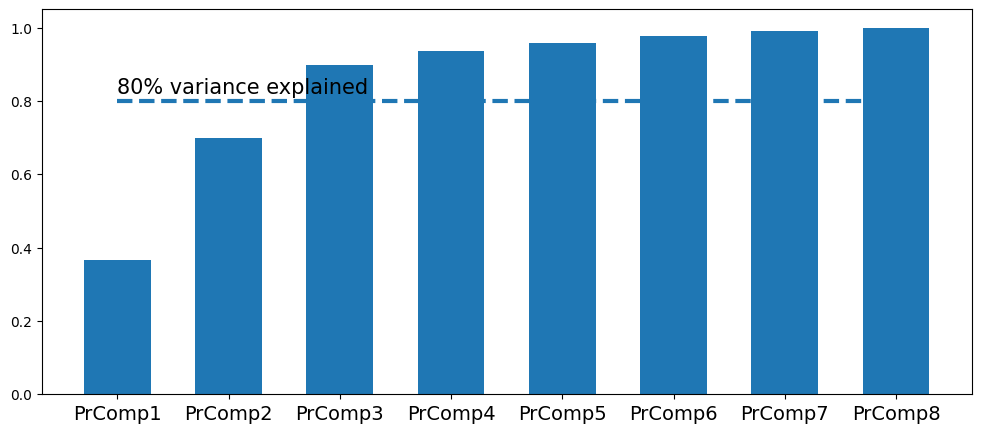

In [49]:
plt.figure(figsize=(12,5))
plt.bar(x=['PrComp'+str(i) for i in range(1,9)],height=cum_explaiend_var,width=0.6)
plt.xticks(fontsize=14)
plt.hlines(y=0.8,xmin='PrComp1',xmax='PrComp8',linestyles='dashed',lw=3)
plt.text(x='PrComp1',y=0.82,s="80% variance explained",fontsize=15)
plt.show()

### Transform the original variables in principal component space and create a DataFrame

In [50]:
X_pca = pca_partial.fit_transform(X_scaled)

In [51]:
df_pca=pd.DataFrame(data=X_pca,columns=['Principal_comp'+str(i) for i in range(1,n_prin_comp+1)])

### Running k-means on the transformed features

In [52]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_pca)
    preds = km.predict(X_pca)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_pca)))
    km_scores.append(-km.score(X_pca))
    silhouette = silhouette_score(X_pca,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -232.2731923132539
Silhouette score for number of cluster(s) 2: 0.41237076480697593
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -131.35124823595504
Silhouette score for number of cluster(s) 3: 0.5530630789685635
V-measure score for number of cluster(s) 3: 0.7918756684685213
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -55.41864327742562
Silhouette score for number of cluster(s) 4: 0.6892187200186618
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -19.03514739692521
Silhouette score for number of cluster(s) 5: 0.7552025555154803
V-measure score for number of cluster(s

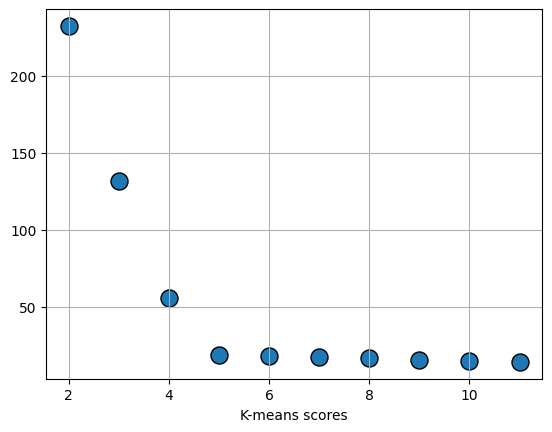

In [53]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("K-means scores")
plt.show()

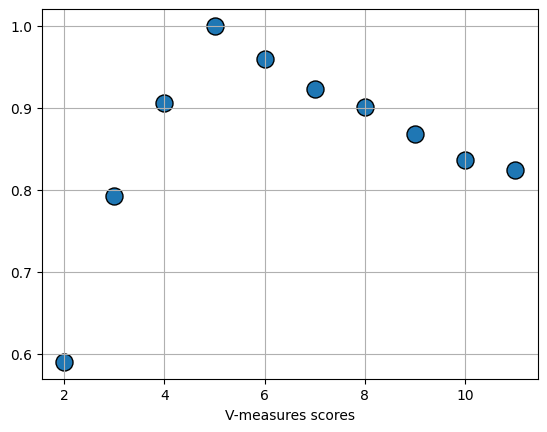

In [54]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("V-measures scores")
plt.show()

### K-means fitting with PCA-transformed data

In [55]:
km_pca = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_pca)
preds_km_pca = km_pca.predict(X_pca)

### Visualizing the clusters after running k-means on PCA-transformed features

In [56]:
col_pca_combi=list(combinations(df_pca.columns,2))
num_pca_combi = len(col_pca_combi)

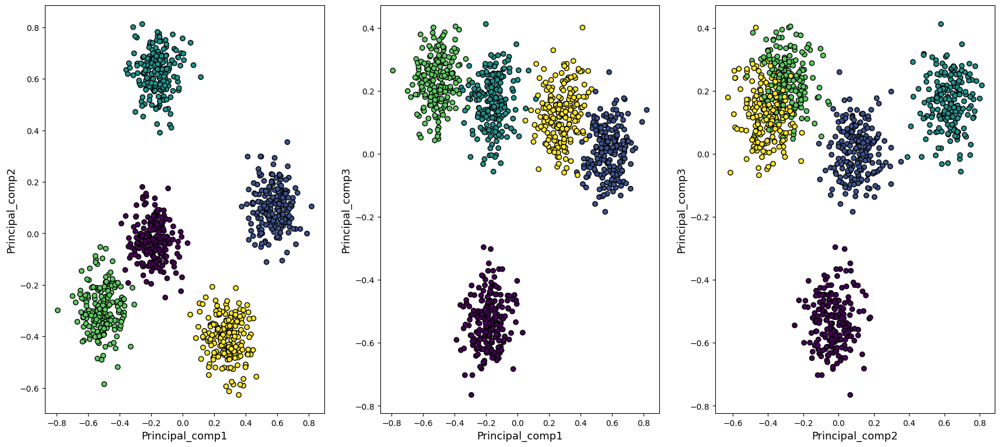

In [57]:
plt.figure(figsize=(21,20))
for i in range(1,num_pca_combi+1):
    plt.subplot(int(num_pca_combi/3)+1,3,i)
    dim1=col_pca_combi[i-1][0]
    dim2=col_pca_combi[i-1][1]
    plt.scatter(df_pca[dim1],df_pca[dim2],c=preds_km_pca,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## ICA

In [58]:
from sklearn.decomposition import FastICA

In [59]:
n_ind_comp = 3

In [60]:
ica_partial = FastICA(n_components=n_ind_comp)
ica_partial.fit(X_scaled)

FastICA(n_components=3)

In [61]:
ica_full = FastICA(max_iter=1000)
ica_full.fit(X_scaled)

/store/venv/da5401/lib/python3.10/site-packages/sklearn/decomposition/_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


FastICA(max_iter=1000)

In [62]:
X_ica = ica_partial.fit_transform(X_scaled)

In [63]:
df_ica=pd.DataFrame(data=X_ica,columns=['Independent_comp'+str(i) for i in range(1,n_ind_comp+1)])

### Running k-means on the independent features

In [64]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_ica)
    preds = km.predict(X_ica)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_ica)))
    km_scores.append(-km.score(X_ica))
    silhouette = silhouette_score(X_ica,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -2049.6666729064964
Silhouette score for number of cluster(s) 2: 0.3728905780625852
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -1255.8665579038825
Silhouette score for number of cluster(s) 3: 0.5206516824860739
V-measure score for number of cluster(s) 3: 0.7918756684685214
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -429.8300781746009
Silhouette score for number of cluster(s) 4: 0.6814502522511829
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -165.24060839803397
Silhouette score for number of cluster(s) 5: 0.7406290383214844
V-measure score for number of cluster(

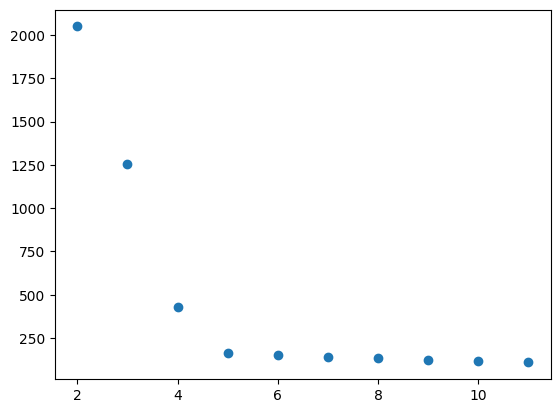

In [65]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores)
plt.show()

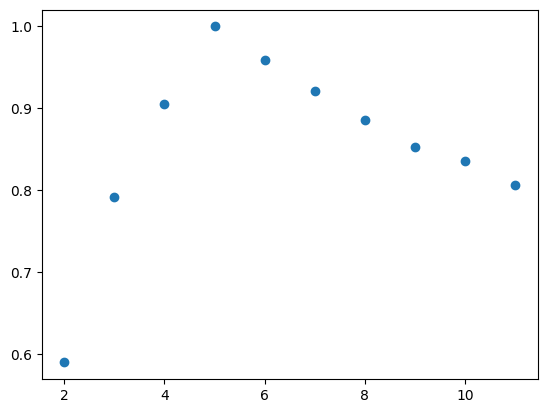

In [66]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score)
plt.show()

### K-means fitting with ICA-transformed data

In [67]:
km_ica = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_ica)
preds_km_ica = km_ica.predict(X_ica)

### Visualizing the clusters after running k-means on ICA-transformed features

In [68]:
col_ica_combi=list(combinations(df_ica.columns,2))
num_ica_combi = len(col_ica_combi)

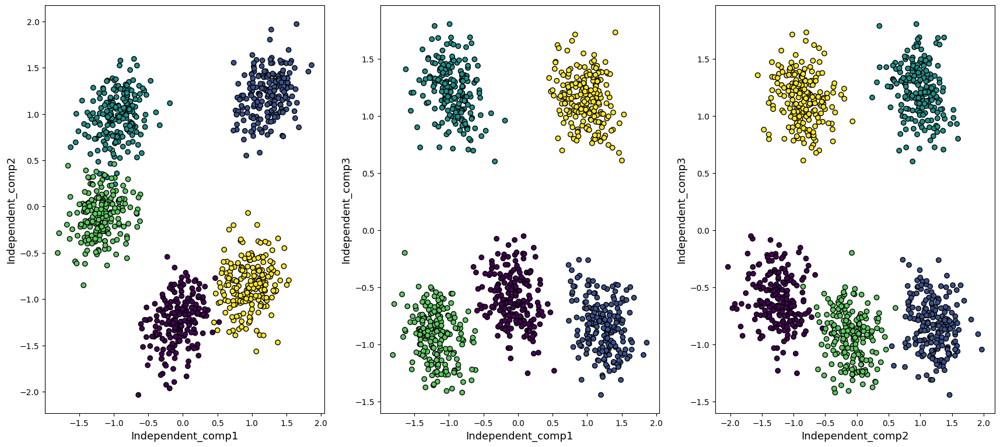

In [69]:
plt.figure(figsize=(21,20))
for i in range(1,num_ica_combi+1):
    plt.subplot(int(num_ica_combi/3)+1,3,i)
    dim1=col_ica_combi[i-1][0]
    dim2=col_ica_combi[i-1][1]
    plt.scatter(df_ica[dim1],df_ica[dim2],c=preds_km_ica,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## Random Projection

In [70]:
from sklearn.random_projection import GaussianRandomProjection

In [71]:
n_random_comp = 3

In [72]:
random_proj = GaussianRandomProjection(n_components=n_random_comp)

In [73]:
X_random_proj = random_proj.fit_transform(X_scaled)

In [74]:
df_random_proj=pd.DataFrame(data=X_random_proj,columns=['Random_projection'+str(i) for i in range(1,n_random_comp+1)])

### Running k-means on random projections

In [75]:
km_scores= []
km_silhouette = []
vmeasure_score = []
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_random_proj)
    preds = km.predict(X_random_proj)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_random_proj)))
    km_scores.append(-km.score(X_random_proj))
    silhouette = silhouette_score(X_random_proj,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -231.43175239985135
Silhouette score for number of cluster(s) 2: 0.5129373057908038
V-measure score for number of cluster(s) 2: 0.5675040346083442
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -112.95168335692917
Silhouette score for number of cluster(s) 3: 0.5952754500382308
V-measure score for number of cluster(s) 3: 0.7304377759665162
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -86.42146367353854
Silhouette score for number of cluster(s) 4: 0.4425824154959224
V-measure score for number of cluster(s) 4: 0.8225748683404599
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -68.63072572351875
Silhouette score for number of cluster(s) 5: 0.4531278012771498
V-measure score for number of cluster(

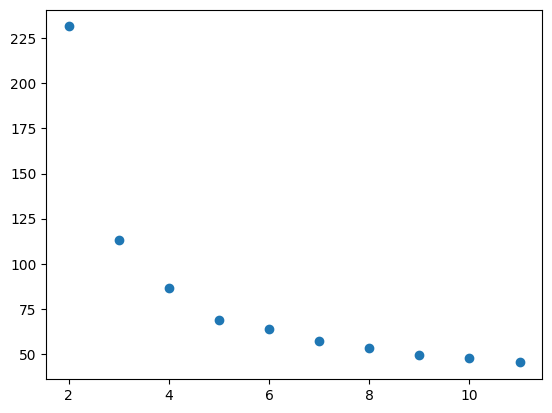

In [76]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores)
plt.show()

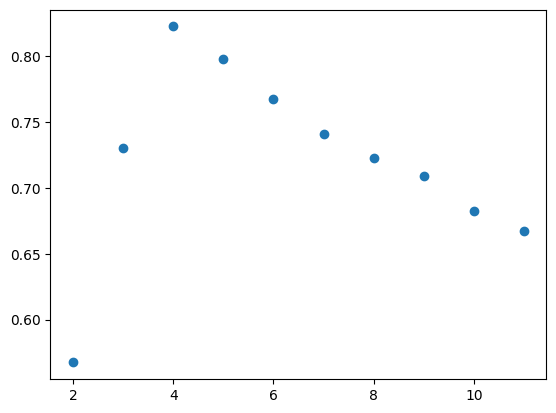

In [77]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score)
plt.show()

### K-means fitting with random-projected data

In [78]:
km_random_proj = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_random_proj)
preds_km_random_proj = km_random_proj.predict(X_random_proj)

### Visualizing the clusters after running k-means on random-projected features

In [79]:
col_random_proj_combi=list(combinations(df_random_proj.columns,2))
num_random_proj_combi = len(col_random_proj_combi)

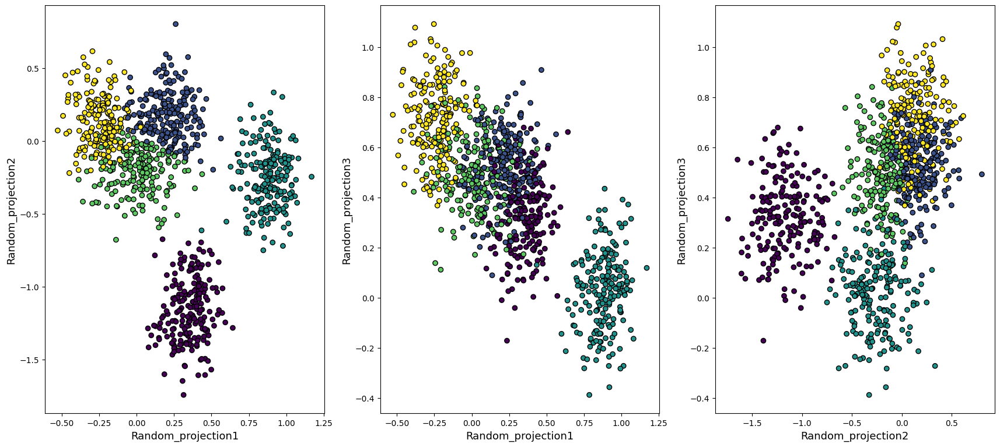

In [80]:
plt.figure(figsize=(21,20))
for i in range(1,num_random_proj_combi+1):
    plt.subplot(int(num_random_proj_combi/3)+1,3,i)
    dim1=col_random_proj_combi[i-1][0]
    dim2=col_random_proj_combi[i-1][1]
    plt.scatter(df_random_proj[dim1],df_random_proj[dim2],c=preds_km_random_proj,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)
plt.show()

In [81]:
def plot_cluster_rp(df_rp,preds_rp):
    """
    Plots clusters after running random projection
    """
    plt.figure(figsize=(21,12))
    for i in range(1,num_random_proj_combi+1):
        plt.subplot(int(num_random_proj_combi/3)+1,3,i)
        dim1=col_random_proj_combi[i-1][0]
        dim2=col_random_proj_combi[i-1][1]
        plt.scatter(df_rp[dim1],df_rp[dim2],c=preds_rp,edgecolor='k')
        plt.xlabel(f"{dim1}",fontsize=13)
        plt.ylabel(f"{dim2}",fontsize=13)
    plt.show()

### Running the random projections many times

Score for iteration 0: -43.12001958819661
Silhouette score for iteration 0: 0.509117284603911
V-measure score for iteration 0: 0.8333299679919024
----------------------------------------------------------------------------------------------------


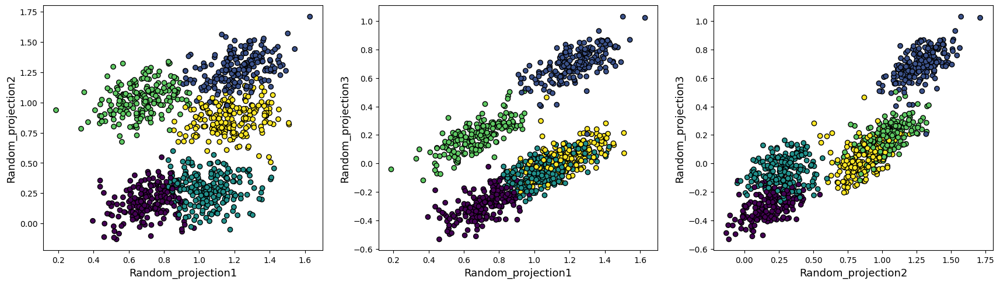

Score for iteration 1: -85.21329545594998
Silhouette score for iteration 1: 0.26590647390221567
V-measure score for iteration 1: 0.45715160487921025
----------------------------------------------------------------------------------------------------


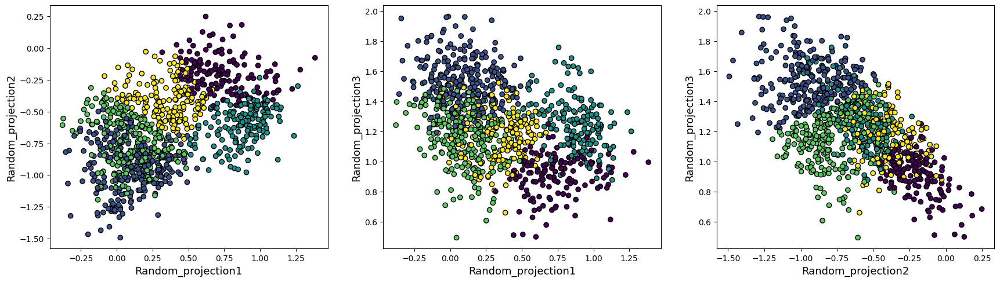

Score for iteration 2: -20.096319683102877
Silhouette score for iteration 2: 0.4678222033521132
V-measure score for iteration 2: 0.808302039421703
----------------------------------------------------------------------------------------------------


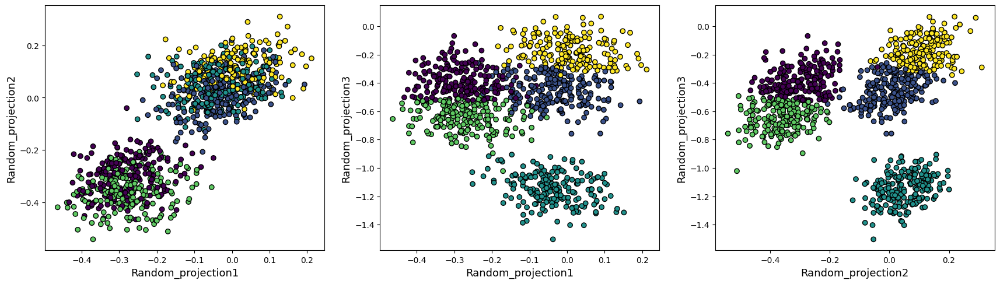

Score for iteration 3: -38.1447237549289
Silhouette score for iteration 3: 0.4043089758487064
V-measure score for iteration 3: 0.7934205084206183
----------------------------------------------------------------------------------------------------


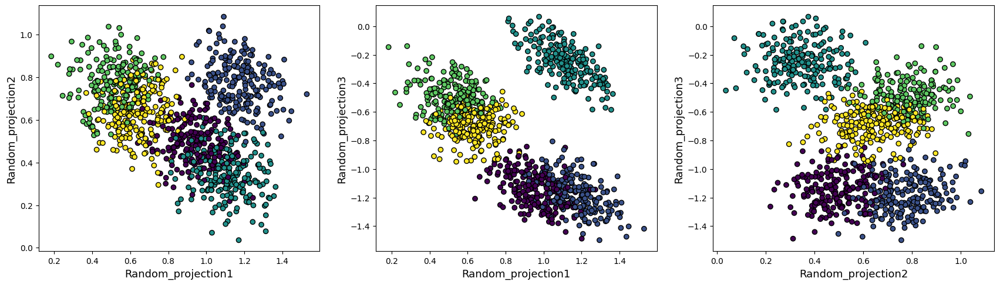

Score for iteration 4: -38.83155443428206
Silhouette score for iteration 4: 0.38758458019751824
V-measure score for iteration 4: 0.6805795028282369
----------------------------------------------------------------------------------------------------


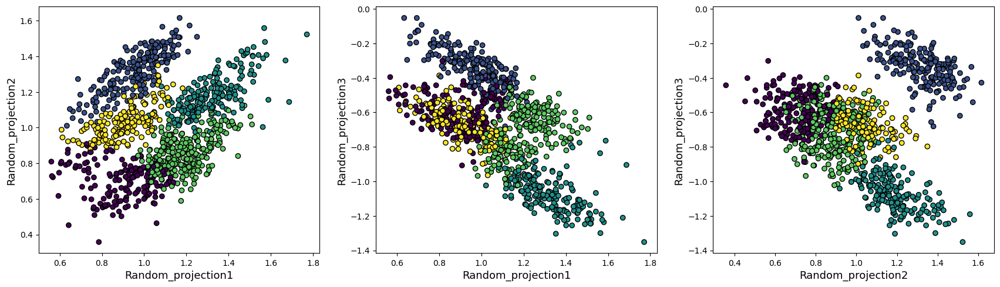

Score for iteration 5: -81.99955259431391
Silhouette score for iteration 5: 0.27290070816231476
V-measure score for iteration 5: 0.4728285537762755
----------------------------------------------------------------------------------------------------


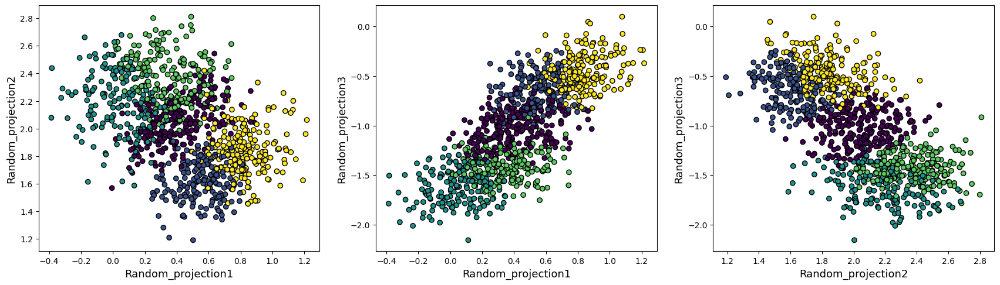

Score for iteration 6: -74.870327976742
Silhouette score for iteration 6: 0.646465310017778
V-measure score for iteration 6: 0.9960866319013287
----------------------------------------------------------------------------------------------------


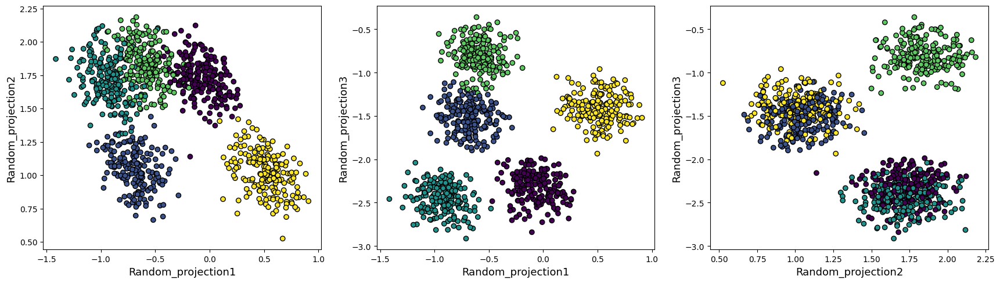

Score for iteration 7: -52.70724573595957
Silhouette score for iteration 7: 0.45498985720337637
V-measure score for iteration 7: 0.8026534163320171
----------------------------------------------------------------------------------------------------


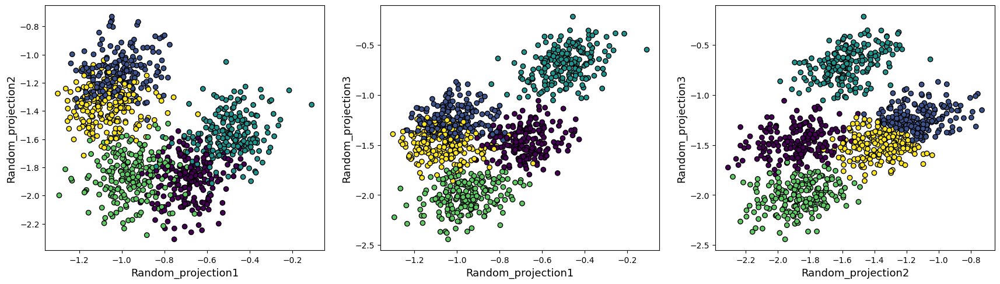

Score for iteration 8: -51.65227203430702
Silhouette score for iteration 8: 0.31895640419922294
V-measure score for iteration 8: 0.5635880632054211
----------------------------------------------------------------------------------------------------


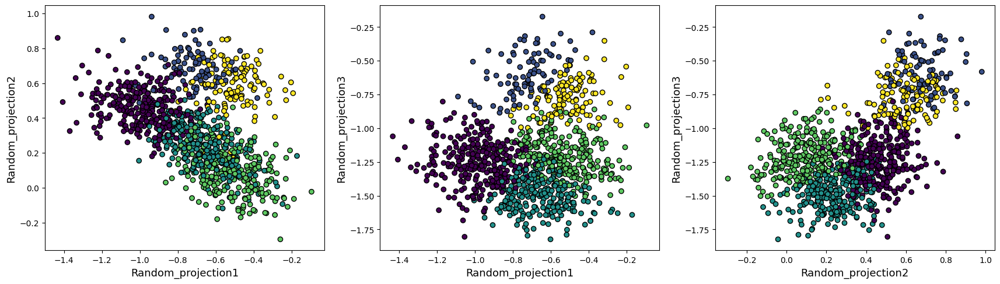

Score for iteration 9: -68.00305885574052
Silhouette score for iteration 9: 0.4975559771962607
V-measure score for iteration 9: 0.8777667899773031
----------------------------------------------------------------------------------------------------


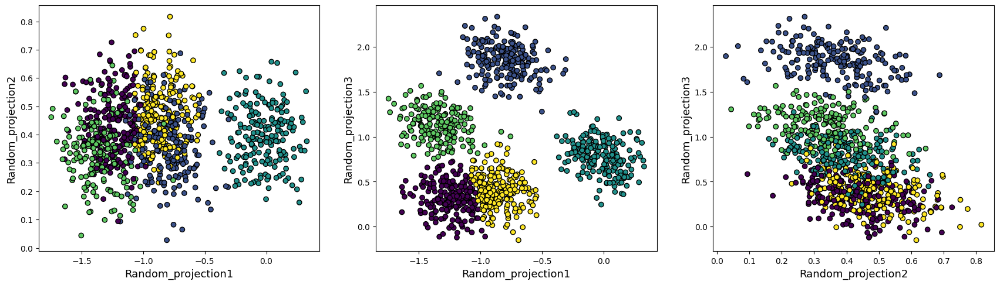

Score for iteration 10: -60.054439381432616
Silhouette score for iteration 10: 0.3815803040207574
V-measure score for iteration 10: 0.6829815085494515
----------------------------------------------------------------------------------------------------


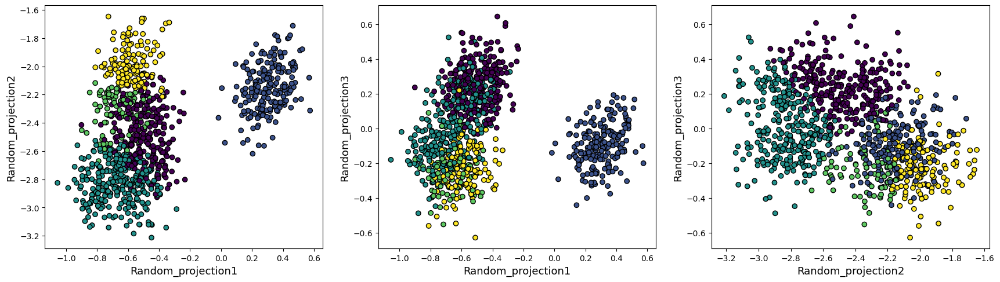

Score for iteration 11: -53.921663729240535
Silhouette score for iteration 11: 0.4716675728227117
V-measure score for iteration 11: 0.8037871912351685
----------------------------------------------------------------------------------------------------


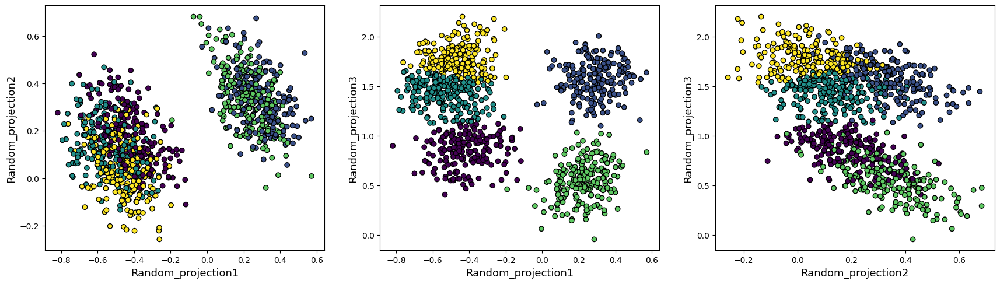

Score for iteration 12: -28.9330742305781
Silhouette score for iteration 12: 0.354170565675488
V-measure score for iteration 12: 0.5194933007317339
----------------------------------------------------------------------------------------------------


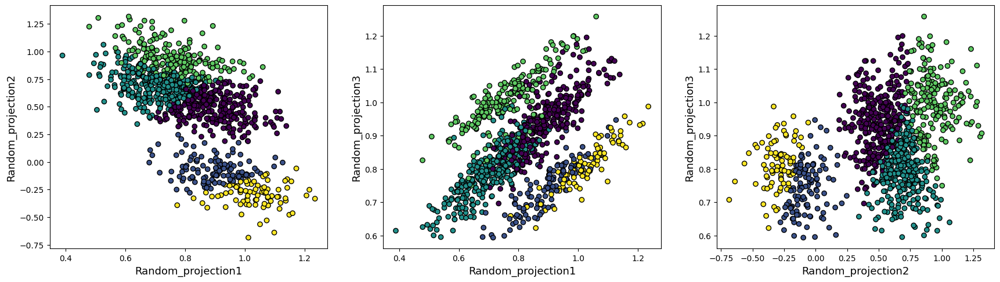

Score for iteration 13: -57.01778850053303
Silhouette score for iteration 13: 0.578080365924123
V-measure score for iteration 13: 0.9891243464871
----------------------------------------------------------------------------------------------------


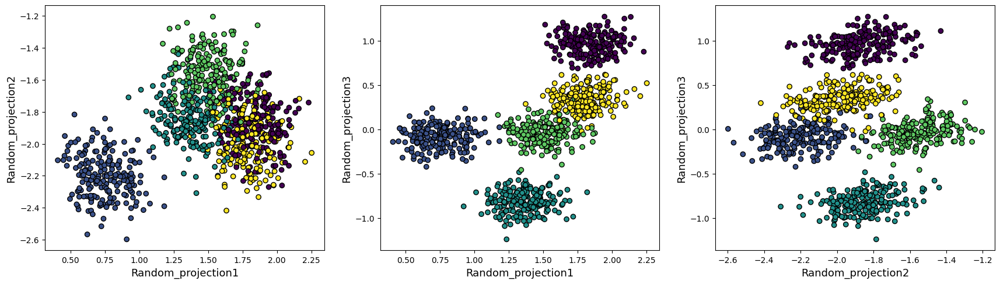

Score for iteration 14: -48.784179712113186
Silhouette score for iteration 14: 0.3471829212541915
V-measure score for iteration 14: 0.5009059442632431
----------------------------------------------------------------------------------------------------


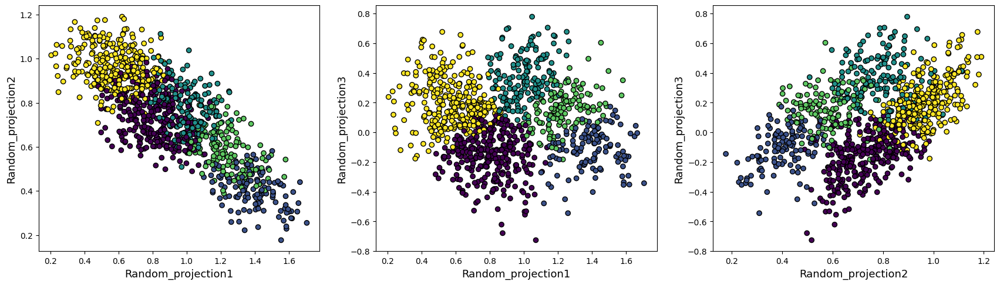

Score for iteration 15: -34.804582714464956
Silhouette score for iteration 15: 0.40651001907905715
V-measure score for iteration 15: 0.8427437503264612
----------------------------------------------------------------------------------------------------


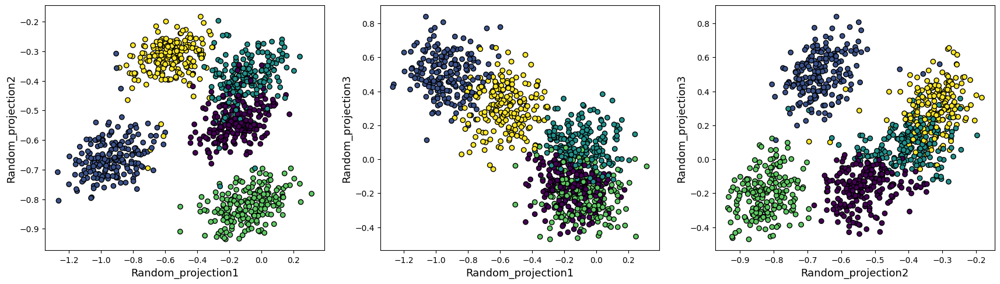

Score for iteration 16: -56.39532369936923
Silhouette score for iteration 16: 0.35773290737189384
V-measure score for iteration 16: 0.6869559209787697
----------------------------------------------------------------------------------------------------


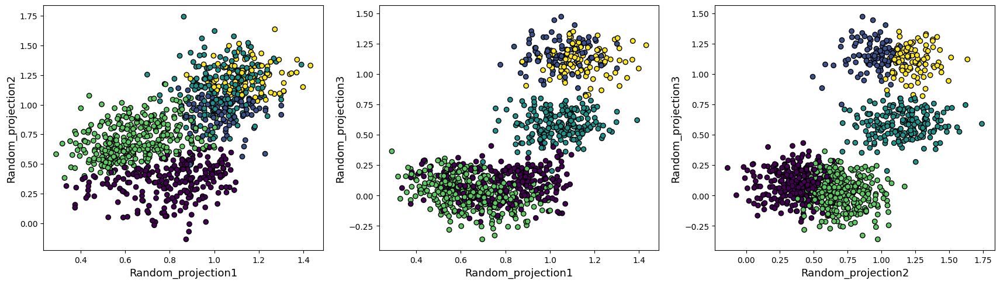

Score for iteration 17: -103.97507299955929
Silhouette score for iteration 17: 0.4440931008003189
V-measure score for iteration 17: 0.8619592662254444
----------------------------------------------------------------------------------------------------


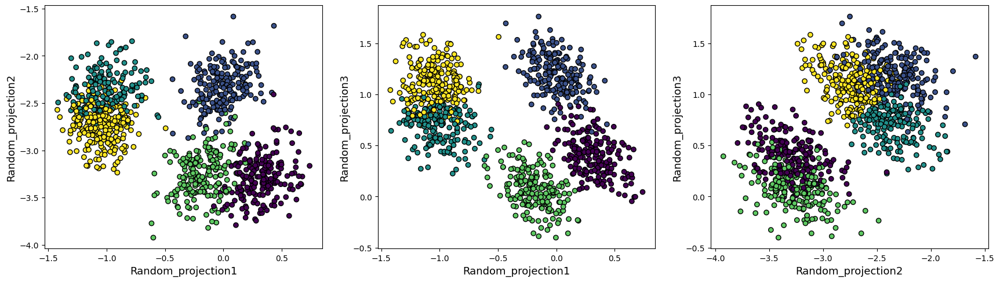

Score for iteration 18: -61.98851080630709
Silhouette score for iteration 18: 0.6170269381147866
V-measure score for iteration 18: 0.9743445123104922
----------------------------------------------------------------------------------------------------


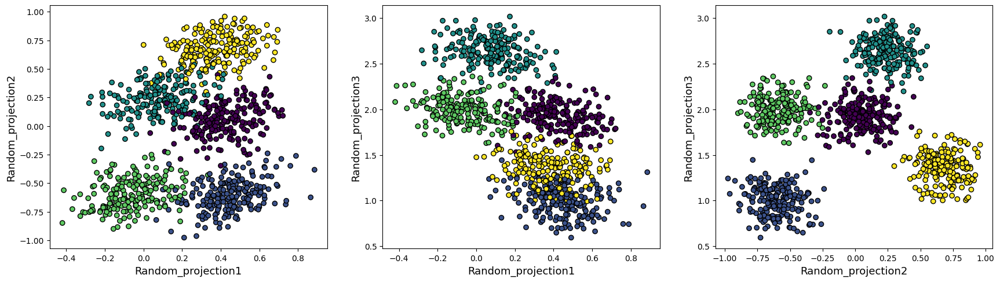

Score for iteration 19: -41.69460172663293
Silhouette score for iteration 19: 0.45834116214343623
V-measure score for iteration 19: 0.8802264290848604
----------------------------------------------------------------------------------------------------


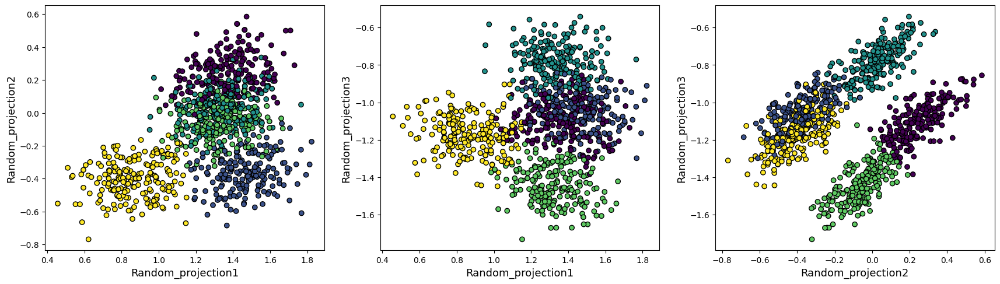

In [82]:
rp_score= []
rp_silhouette = []
rp_vmeasure = []
for i in range(20):
    random_proj = GaussianRandomProjection(n_components=n_random_comp)
    X_random_proj = random_proj.fit_transform(X_scaled)
    df_random_proj=pd.DataFrame(data=X_random_proj,columns=['Random_projection'+str(i) for i in range(1,n_random_comp+1)])
    
    km = KMeans(n_clusters=5, random_state=0).fit(X_random_proj)
    preds = km.predict(X_random_proj)
    print("Score for iteration {}: {}".format(i,km.score(X_random_proj)))
    rp_score.append(-km.score(X_random_proj))
    
    silhouette = silhouette_score(X_random_proj,preds)
    rp_silhouette.append(silhouette)
    print("Silhouette score for iteration {}: {}".format(i,silhouette))
    
    v_measure = v_measure_score(y,preds)
    rp_vmeasure.append(v_measure)
    print("V-measure score for iteration {}: {}".format(i,v_measure))
    print("-"*100)
    
    plot_cluster_rp(df_random_proj,preds)

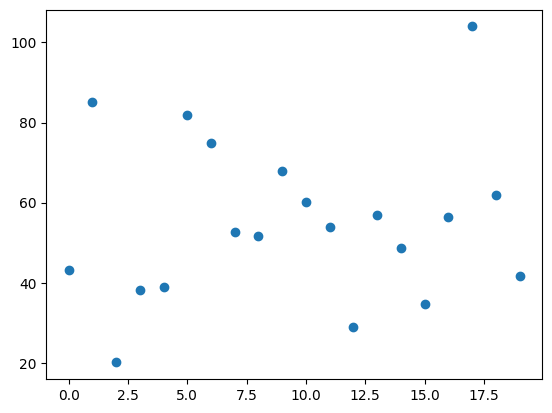

In [83]:
plt.scatter(x=[i for i in range(20)],y=rp_score)
plt.show()

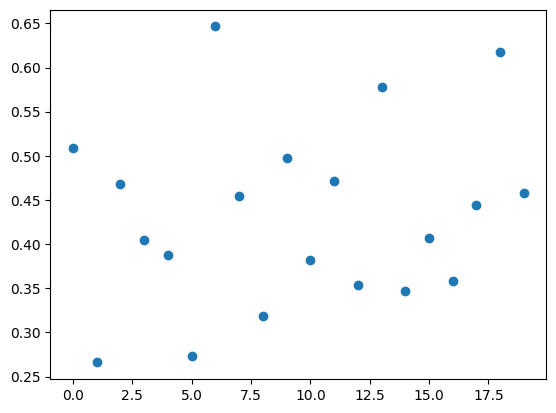

In [84]:
plt.scatter(x=[i for i in range(20)],y=rp_silhouette)
plt.show()

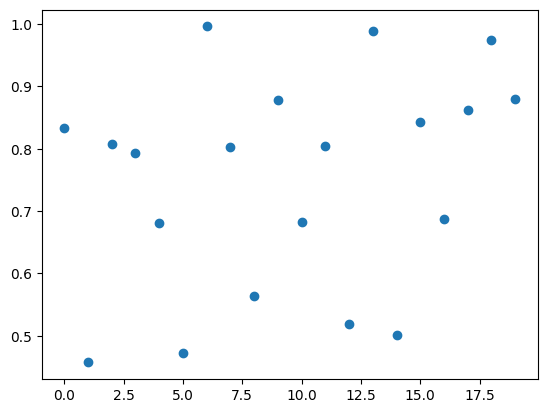

In [85]:
plt.scatter(x=[i for i in range(20)],y=rp_vmeasure)
plt.show()

### This kind of variation does not happen with PCA

In [86]:
pca_score= []
pca_silhouette = []
pca_vmeasure = []
for i in range(20):
    pca_partial = PCA(n_components=n_prin_comp,svd_solver='full')
    X_pca=pca_partial.fit_transform(X_scaled)
    km = KMeans(n_clusters=5, random_state=0).fit(X_pca)
    preds = km.predict(X_pca)
    print("Score for iteration {}: {}".format(i,km.score(X_pca)))
    rp_score.append(-km.score(X_pca))
    silhouette = silhouette_score(X_pca,preds)
    rp_silhouette.append(silhouette)
    print("Silhouette score for iteration {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    rp_vmeasure.append(v_measure)
    print("V-measure score for iteration {}: {}".format(i,v_measure))
    print("-"*100)

Score for iteration 0: -19.035147396925208
Silhouette score for iteration 0: 0.7552025555154803
V-measure score for iteration 0: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 1: -19.035147396925208
Silhouette score for iteration 1: 0.7552025555154803
V-measure score for iteration 1: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 2: -19.035147396925208
Silhouette score for iteration 2: 0.7552025555154803
V-measure score for iteration 2: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 3: -19.035147396925208
Silhouette score for iteration 3: 0.7552025555154803
V-measure score for iteration 3: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 4: -19.03514739692521
Silhouette score for i